In [2]:
import os, sys 
import torch 
import datetime
from pprint import pprint
import matplotlib.pyplot as plt
import numpy as np
from pprint import pprint
import IPython.display as ipd
from argparse import Namespace
import torch.nn as nn 
import torch.nn.functional as F
import librosa
import argparse
import scipy 
from IPython.display import Audio
import numpy as np
from matplotlib.pyplot import cm
from tqdm import tqdm

sys.path.append("../../")

# import two_s
# import end2end_unsupervised_separation.dnn.losses.sdr as sdr_loss
# import end2end_unsupervised_separation.dnn.losses.sisnr as sisnr_loss
# import end2end_unsupervised_separation.dnn.utils.model_logger as \
#     model_logger
# from end2end_unsupervised_separation.dnn.dataset_loader\
#     .torch_dataloader import End2EndMixtureDataset,  \
#                              get_data_gen_from_loader
# import two.dnn.losses.sdr as perm_inv_sdr
# import end2end_unsupervised_separation.dnn.losses.sisnr as perm_inv_sisnr


In [3]:
from __config__ import *
import two_step_mask_learning.dnn.models.conv_tasnet_maskregress as mask_tasnet
import two_step_mask_learning.dnn.models.simplified_tasnet as simple_tasnet
import two_step_mask_learning.dnn.dataset_loader.augmented_mix_dataloader as augmented_dataloader
import two_step_mask_learning.dnn.dataset_loader.torch_dataloader as wsjnormpad_loader
import two_step_mask_learning.dnn.losses.sisdr as sisdr_lib
import two_step_mask_learning.dnn.models.adaptive_frontend as adaptive_fe

asdfasddfsasfdasfda
/home/thymios/afes/augmented/ESC50_1.0
/home/thymios/afes/augmented/ESC50_1.0/reg_softmax_L_128_N_21


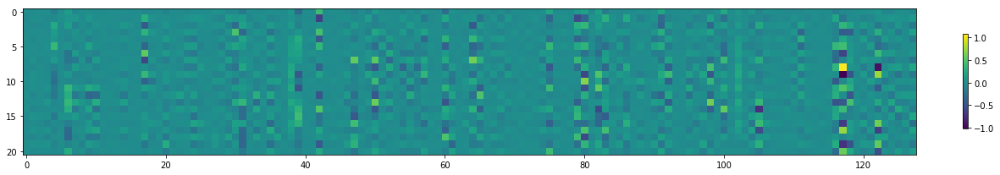

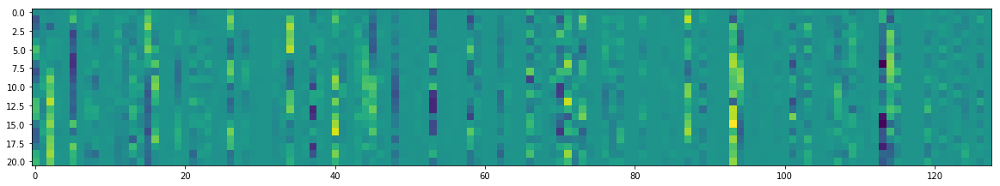

In [96]:
mask_model_path = '/home/thymios/tn_mask/augmented/ESC50_1.0/'
a_mask_model = mask_tasnet.CTN.load_best_model(mask_model_path, 'softmax', 128, 21, 0.)
mask_enc = a_mask_model.encoder.conv.weight.detach().cpu().squeeze().numpy().T
mask_dec = a_mask_model.decoder.deconv.weight.detach().cpu().squeeze().numpy().T
# print the encoder 
plt.figure(figsize=(20,10))
im = plt.imshow(mask_enc, interpolation='nearest')
plt.colorbar(im, fraction=0.005)
plt.show()

plt.figure(figsize=(20,10))
im = plt.imshow(mask_dec[:, :mask_dec.shape[-1]//2], interpolation='nearest')
# plt.colorbar(im, fraction=0.005)
plt.show()

asdfasddfsasfdasfda
/home/thymios/afes/norm_pad/
/home/thymios/afes/norm_pad/reg_softmax_L_32_N_21


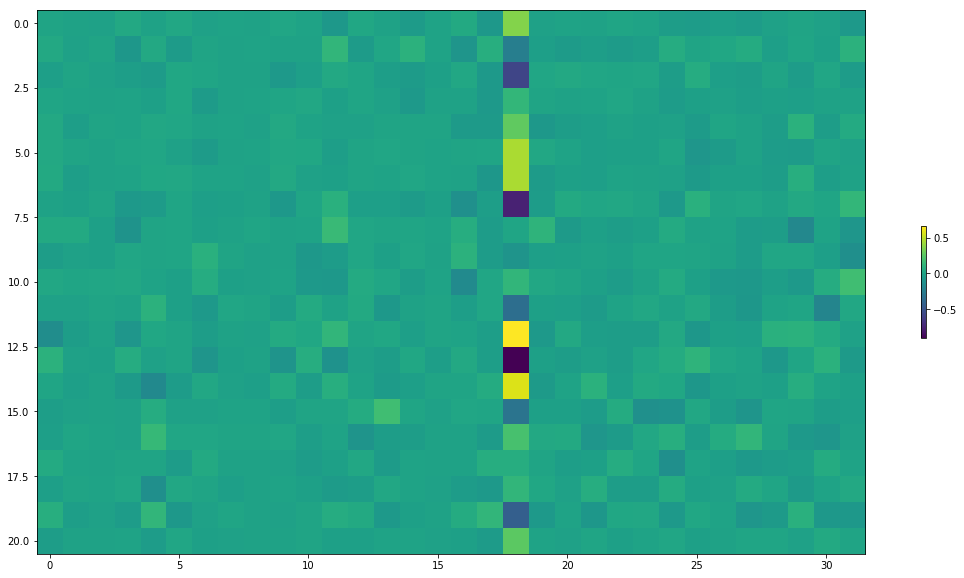

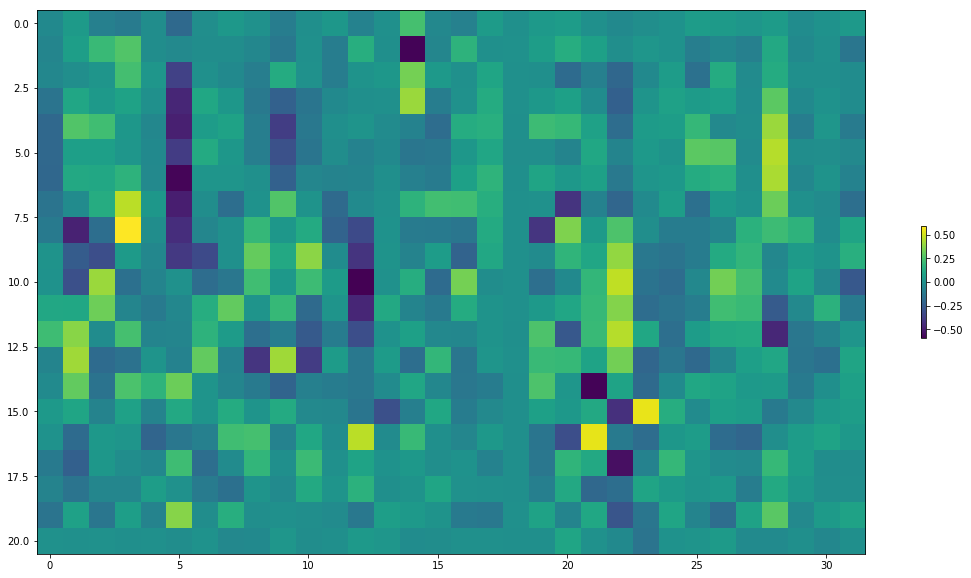

In [5]:
mask_model_path = '/home/thymios/tn_mask/norm_pad/'
a_mask_model = mask_tasnet.CTN.load_best_model(mask_model_path, 'softmax', 32, 21, 2.)
mask_enc = a_mask_model.encoder.conv.weight.detach().cpu().squeeze().numpy().T
mask_dec = a_mask_model.decoder.deconv.weight.detach().cpu().squeeze().numpy().T
# print the encoder 
plt.figure(figsize=(20,10))
im = plt.imshow(mask_enc, interpolation='nearest')
plt.colorbar(im, fraction=0.005)
plt.show()

plt.figure(figsize=(20,10))
im = plt.imshow(mask_dec[:, :mask_dec.shape[-1]//2], interpolation='nearest')
plt.colorbar(im, fraction=0.005)
plt.show()

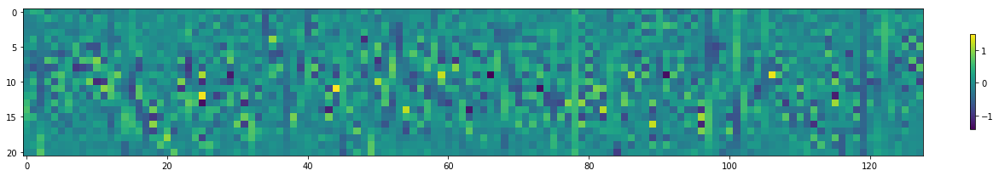

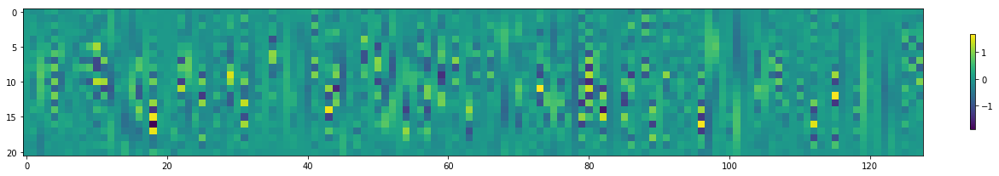

In [6]:
simple_tasnet_model_path = '/home/thymios/tn_mask/augmented/WSJMIX_0.5_ESC50_0.5/'
a_tasnet_model = simple_tasnet.GLNFullThymiosCTN.load_best_model(simple_tasnet_model_path, 128, 21)
mask_enc = a_tasnet_model.fe[0].weight.detach().cpu().squeeze().numpy().T
mask_dec = a_tasnet_model.be.weight.detach().cpu().squeeze().numpy().T
# print the encoder 
plt.figure(figsize=(20,10))
im = plt.imshow(mask_enc, interpolation='nearest')
plt.colorbar(im, fraction=0.005)
plt.show()

plt.figure(figsize=(20,10))
im = plt.imshow(mask_dec[:, :mask_dec.shape[-1]//2], interpolation='nearest')
plt.colorbar(im, fraction=0.005)
plt.show()

In [7]:
a_tasnet_model.fe[0].weight

Parameter containing:
tensor([[[ 0.0326, -0.1517, -0.1793,  ...,  0.0740,  0.0631, -0.0429]],

        [[ 0.4185, -0.1043, -0.1529,  ...,  0.0125,  0.1948, -0.0182]],

        [[ 0.3555,  0.0877, -0.0545,  ...,  0.5801,  0.4724,  0.7104]],

        ...,

        [[-0.0800, -0.0939,  0.3768,  ...,  0.0208, -0.0678, -0.0530]],

        [[-0.0691,  0.1360,  0.1152,  ..., -0.0167,  0.0242,  0.0255]],

        [[-0.0223,  0.3045, -0.0450,  ..., -0.0354, -0.0013, -0.1003]]],
       requires_grad=True)

In [8]:
# Try to get some representations of sounds from WSJ and ESC50
WSJ_MIX_HIERARCHICAL_P = '/mnt/nvme/hierarchical_sound_datasets/WSJ0_mix_partitioned/train'
ESC50_HIERARCHICAL_P = '/mnt/nvme/hierarchical_sound_datasets/ESC50_partitioned/train'
these_args = argparse.Namespace(
            input_dataset_p=[WSJ_MIX_HIERARCHICAL_P, ESC50_HIERARCHICAL_P],
            datasets_priors=[0.2, 0.8],
            batch_size=1,
            n_jobs=1,
            n_samples=1,
            return_items=['wav'],
            fs=8000.,
            selected_timelength=4.,
            n_sources=2,
            max_abs_snr=2.5,
            fixed_seed=0
        )

data_loader = augmented_dataloader.AugmentedOnlineMixingDataset(
    **vars(these_args))
train_val_gen = augmented_dataloader.get_data_gen_from_loader(data_loader)

Dataset is going to be created online for: 1 samples


In [9]:
for mixture, sources in train_val_gen:
    mix_wav = mixture.squeeze()
    s1_wav = sources.squeeze()[0]
    s2_wav = sources.squeeze()[1]
    print('Mixture')
    ipd.display(Audio(mix_wav, rate=8000))
    print('Source 1')
    ipd.display(Audio(s1_wav, rate=8000))
    print(mixture.shape)
    print('Source 2')
    ipd.display(Audio(s2_wav, rate=8000))
    print(sources.shape)

Mixture


Source 1


torch.Size([1, 32000])
Source 2


torch.Size([1, 2, 32000])


In [10]:
mix_wav = mix_wav.detach().cpu().numpy()
s1_wav = s1_wav.detach().cpu().numpy()
s2_wav = s2_wav.detach().cpu().numpy()

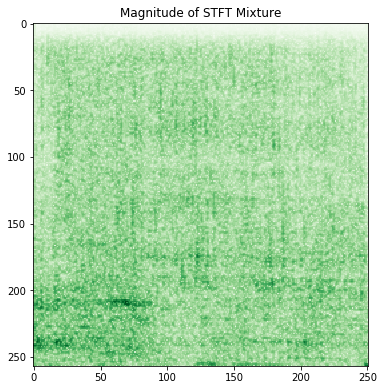

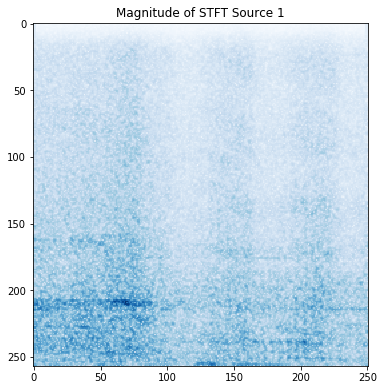

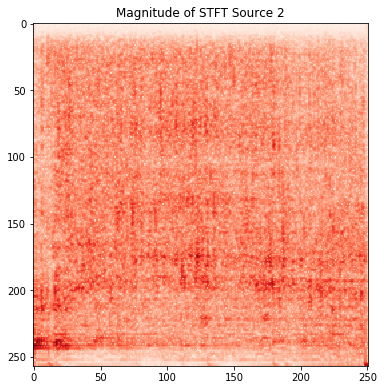

In [11]:
# Visualize the stfts
n_fft = 512
hop_length = int(n_fft / 4) 
win_length = n_fft 
mix_stft = librosa.core.stft(mix_wav, n_fft=n_fft, hop_length=hop_length, win_length=win_length)
mix_stft = mix_stft[::-1, :]
s1_stft = librosa.core.stft(s1_wav, n_fft=n_fft, hop_length=hop_length, win_length=win_length)
s1_stft = s1_stft[::-1, :]
s2_stft = librosa.core.stft(s2_wav, n_fft=n_fft, hop_length=hop_length, win_length=win_length)
s2_stft = s2_stft[::-1, :]

plt.figure(figsize=(6,10))
# plt.axes([1, 4, 3, 20])
plt.title('Magnitude of STFT Mixture')
plt.imshow(1 - np.abs(mix_stft)**0.3, cmap=cm.Greens_r)
plt.show()

plt.figure(figsize=(6,10))
# plt.axes([1, 4, 3, 20])
plt.title('Magnitude of STFT Source 1')
plt.imshow(1 - np.abs(s1_stft)**0.3, cmap=cm.Blues_r)
plt.show()

plt.figure(figsize=(6,10))
# plt.axes([1, 4, 3, 20])
plt.title('Magnitude of STFT Source 2')
plt.imshow(1 - np.abs(s2_stft)**0.3, cmap=cm.Reds_r)
plt.show()

In [73]:
def plot_encoded(mix_encoded, s1_encoded, s2_encoded, exponent=0.003):
    plt.figure(figsize=(100,10))
    plt.imshow(mix_encoded**exponent, cmap=cm.Greens_r)
    plt.title('Mixture encoded', fontsize=40)
    plt.show()

    plt.figure(figsize=(100,10))
    plt.imshow(s1_encoded**exponent, interpolation='nearest', cmap=cm.Blues_r)
    plt.title('Source 1 Mask', fontsize=40)
    plt.show()

    plt.figure(figsize=(100,10))
    plt.imshow(s2_encoded**exponent, interpolation='nearest', cmap=cm.Reds_r)
    plt.title('Source 2 Mask', fontsize=40)
    plt.show()
    
    plt.figure(figsize=(100,10))
    plt.imshow(abs(s2_encoded - s1_encoded)**exponent , interpolation='nearest', cmap=cm.Reds_r)
    plt.title('Source 2 - Source 1', fontsize=40)
    plt.show()
    
    plt.figure(figsize=(100,10))
    plt.imshow((s1_encoded / s1_encoded.max())**exponent , interpolation='nearest', cmap=cm.Blues_r, alpha=0.7)
    plt.imshow((s2_encoded / s2_encoded.max())**exponent , interpolation='nearest', cmap=cm.Reds_r, alpha=0.6)
    plt.title('Superposition', fontsize=40)
    plt.show()
    #     plt.subplot(744)
#     plt.imshow(np.abs(s2_encoded - s1_encoded)**0.3)
#     plt.title('Mask Difference', fontsize=40)
#     plt.subplot(725)
#     plt.imshow(np.abs(enc_basis.T)**0.5)
#     plt.title('Encoder basis Magnitude', fontsize=40)
#     plt.subplot(726)
#     plt.imshow(np.abs(dec_basis.T)**0.5)
#     plt.title('Decoder basis Magnitude', fontsize=40)
    
#     plt.subplot(716)
#     # plt.imshow(s2_enc**0.3)
#     plt.imshow(np.abs(m1_s1_enc + m1_s2_enc)**0.3)
#     plt.title('s2-encoded')
#     plt.subplot(717)
#     plt.imshow(np.abs(m1_s1_enc - m1_s2_enc)**0.3)
#     plt.title('s1 + s2')
#     plt.subplots_adjust(wspace=0.1, 
#                         hspace=0.01, 
#                         top=0.7, 
#                         bottom=0.)
    plt.show()

asdfasddfsasfdasfda
/home/thymios/afes/augmented/WSJMIX_0.5_ESC50_0.5
/home/thymios/afes/augmented/WSJMIX_0.5_ESC50_0.5/reg_softmax_L_128_N_21


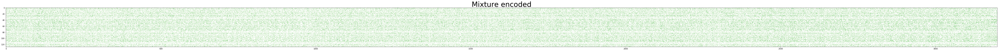

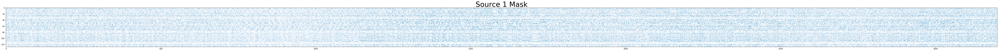

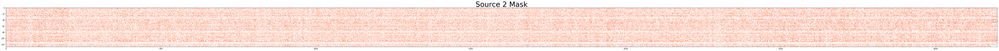

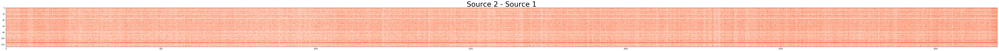

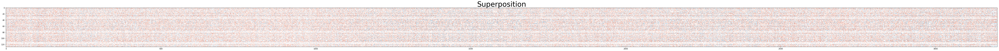

tensor([[[-0.0215,  0.0041, -0.0093,  ...,  0.0094, -0.0035, -0.0091]]])
torch.Size([1, 128, 3200])
torch.Size([1, 128])


In [94]:
mask_model_path = '/home/thymios/tn_mask/augmented/WSJMIX_0.5_ESC50_0.5/'
a_mask_model = mask_tasnet.CTN.load_best_model(mask_model_path, 'softmax', 128, 21, 0.)
mask_enc = a_mask_model.encoder
mask_dec = a_mask_model.decoder

mix_encoded = mask_enc(torch.tensor(mix_wav).unsqueeze(0).unsqueeze(0)) 
s1_encoded = mask_enc(torch.tensor(s1_wav).unsqueeze(0).unsqueeze(0)) 
s2_encoded = mask_enc(torch.tensor(s2_wav).unsqueeze(0).unsqueeze(0)) 
mix_encoded -= torch.mean(mix_encoded, 2, keepdim=True)
s1_encoded -= torch.mean(s1_encoded, 2, keepdim=True)
s2_encoded -= torch.mean(s2_encoded, 2, keepdim=True)

plot_encoded(mix_encoded.squeeze(), s1_encoded.squeeze(), s2_encoded.squeeze(), exponent=0.01)
# plot_for_encoder(mask_enc, mask_dec, mix_wav, s1_wav, s2_wav)
print(torch.mean(mix_encoded, 1, keepdim=True))
print(mix_encoded.shape)
print(torch.mean(mix_encoded, 2).shape)

asdfasddfsasfdasfda
/home/thymios/afes/augmented/WSJMIX_0.5_ESC50_0.5
/home/thymios/afes/augmented/WSJMIX_0.5_ESC50_0.5/reg_softmax_L_128_N_21


/home/thymios/.local/lib/python3.5/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in power
  This is separate from the ipykernel package so we can avoid doing imports until


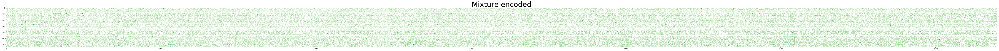

/home/thymios/.local/lib/python3.5/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in power
  


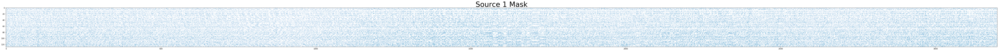

/home/thymios/.local/lib/python3.5/site-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in power
  del sys.path[0]


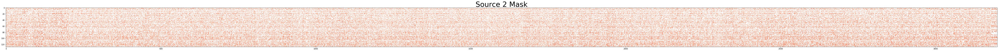

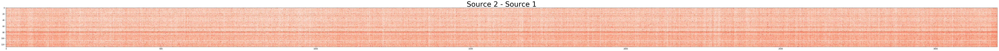

/home/thymios/.local/lib/python3.5/site-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in power
/home/thymios/.local/lib/python3.5/site-packages/ipykernel_launcher.py:24: RuntimeWarning: invalid value encountered in power


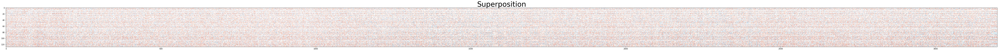

In [93]:
# What if we rearrange the basis of the encoder???

mask_model_path = '/home/thymios/tn_mask/augmented/WSJMIX_0.5_ESC50_0.5/'
a_mask_model = mask_tasnet.CTN.load_best_model(mask_model_path, 'softmax', 128, 21, 0.)
mask_enc = a_mask_model.encoder
mask_dec = a_mask_model.decoder

enc_basis = mask_enc.conv.weight.squeeze().numpy()
enc_bias = mask_enc.conv.bias.squeeze().numpy()

def zero_crossings(m):
    signs = np.sign(m)
    zcs = np.abs(signs[1:,:] - signs[:-1,:]) / 2.
    return zcs

n_time_samples, n_freqs = enc_basis.T.shape
zero_cross_per_col = zero_crossings(enc_basis.T)
e = enc_basis.T[:, np.argsort(np.sum(zero_cross_per_col, axis=0))]
new_bias = enc_bias[np.argsort(np.sum(zero_cross_per_col, axis=0))]

mask_enc.conv.weight = torch.nn.Parameter(torch.tensor(e.T).unsqueeze(1))
mask_enc.conv.bias = torch.nn.Parameter(torch.tensor(new_bias).squeeze())


mix_encoded = mask_enc(torch.tensor(mix_wav).unsqueeze(0).unsqueeze(0)).detach().numpy()
s1_encoded = mask_enc(torch.tensor(s1_wav).unsqueeze(0).unsqueeze(0)).detach().numpy()
s2_encoded = mask_enc(torch.tensor(s2_wav).unsqueeze(0).unsqueeze(0)).detach().numpy()
mix_encoded -= np.mean(mix_encoded, axis=2, keepdims=True)
s1_encoded -= np.mean(s1_encoded, axis=2, keepdims=True)
s2_encoded -= np.mean(s2_encoded, axis=2, keepdims=True)

plot_encoded(mix_encoded.squeeze(), s1_encoded.squeeze(), s2_encoded.squeeze(), exponent=0.001)
# plot_encoded(mix_encoded.squeeze(), s1_encoded.squeeze(), s2_encoded.squeeze())

In [62]:
# What if we rearrange the basis of the encoder with the energy of the basis vectors???

mask_model_path = '/home/thymios/tn_mask/augmented/WSJMIX_0.5_ESC50_0.5/'
a_mask_model = mask_tasnet.CTN.load_best_model(mask_model_path, 'softmax', 128, 21, 0.)
mask_enc = a_mask_model.encoder
mask_dec = a_mask_model.decoder

enc_basis = mask_enc.conv.weight.squeeze().numpy()
enc_bias = mask_enc.conv.bias.squeeze().numpy()

e = enc_basis.T[:, np.argsort(np.sum(np.abs(enc_basis.T), axis=0))]
new_bias = enc_bias[np.argsort(np.sum(np.abs(enc_basis.T), axis=0))]

mask_enc.conv.weight = torch.nn.Parameter(torch.tensor(e.T).unsqueeze(1))
mask_enc.conv.bias = torch.nn.Parameter(torch.tensor(new_bias).squeeze())


mix_encoded = mask_enc(torch.tensor(mix_wav).unsqueeze(0).unsqueeze(0)).detach().numpy()
s1_encoded = mask_enc(torch.tensor(s1_wav).unsqueeze(0).unsqueeze(0)).detach().numpy()
s2_encoded = mask_enc(torch.tensor(s2_wav).unsqueeze(0).unsqueeze(0)).detach().numpy()
# plot_encoded(mix_encoded.squeeze(), s1_encoded.squeeze(), s2_encoded.squeeze(), exponent=1)

# Measure the sparsity 
print("L1 sparsity")
print(np.abs(s1_encoded - np.mean(s1_encoded, axis=2, keepdims=True)).sum(),
      np.abs(s2_encoded - np.mean(s2_encoded, axis=2, keepdims=True)).sum(),
      np.abs(mix_encoded - np.mean(mix_encoded, axis=2, keepdims=True)).sum())
print("L0 sparsity")
print(np.abs(s1_encoded - np.mean(s1_encoded, axis=2, keepdims=True)).sum(),
      np.abs(s2_encoded - np.mean(s2_encoded, axis=2, keepdims=True)).sum(),
      np.abs(mix_encoded - np.mean(mix_encoded, axis=2, keepdims=True)).sum())
print(1. * np.count_nonzero(np.abs(s1_encoded - np.mean(s1_encoded, axis=2, keepdims=True))) / np.prod(s1_encoded.shape))
print(1. * np.count_nonzero(np.abs(s2_encoded - np.mean(s2_encoded, axis=2, keepdims=True))) / np.prod(s1_encoded.shape))
print(1. * np.count_nonzero(np.abs(mix_encoded - np.mean(mix_encoded, axis=2, keepdims=True))) / np.prod(s1_encoded.shape))


asdfasddfsasfdasfda
/home/thymios/afes/augmented/WSJMIX_0.5_ESC50_0.5
/home/thymios/afes/augmented/WSJMIX_0.5_ESC50_0.5/reg_softmax_L_128_N_21
L1 sparsity
25193.105 45982.55 53859.848
L0 sparsity
25193.105 45982.55 53859.848
1.0
1.0
1.0


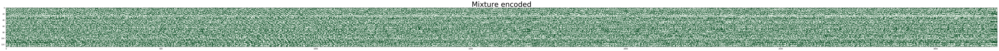

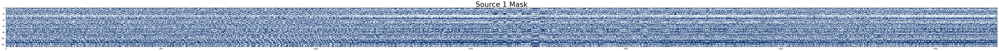

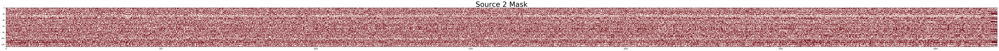

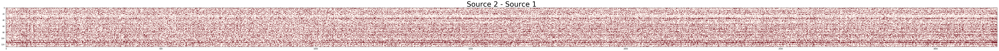

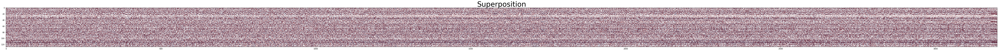

L1 sparsity
166916.53 208855.81 283143.66
L0 sparsity
166916.53 208855.81 283143.66
1.0
1.0
1.0


In [63]:
# Check what happens with the masks learned from a simple tasnet
simple_tasnet_model_path = '/home/thymios/tn_mask/augmented/WSJMIX_0.5_ESC50_0.5/'
a_tasnet_model = simple_tasnet.GLNFullThymiosCTN.load_best_model(simple_tasnet_model_path, 128, 21)
# mask_enc = a_tasnet_model.fe[0].weight.detach().cpu().squeeze().numpy().T
# mask_dec = a_tasnet_model.be.weight.detach().cpu().squeeze().numpy().T


enc_basis = a_tasnet_model.fe[0].weight.squeeze().detach().cpu().numpy()
enc_bias = a_tasnet_model.fe[0].bias.squeeze().detach().cpu().numpy()

e = enc_basis.T[:, np.argsort(np.sum(np.abs(enc_basis.T), axis=0))]
new_bias = enc_bias[np.argsort(np.sum(np.abs(enc_basis.T), axis=0))]

# a_tasnet_model.fe[0].weight = torch.nn.Parameter(torch.tensor(e.T).unsqueeze(1))
# a_tasnet_model.fe[0].bias = torch.nn.Parameter(torch.tensor(new_bias).squeeze())


mix_encoded = a_tasnet_model.fe[0](torch.tensor(mix_wav).unsqueeze(0).unsqueeze(0))
s1_encoded = a_tasnet_model.fe[0](torch.tensor(s1_wav).unsqueeze(0).unsqueeze(0))
s2_encoded = a_tasnet_model.fe[0](torch.tensor(s2_wav).unsqueeze(0).unsqueeze(0))

mix_encoded = a_tasnet_model.fe[1](mix_encoded).detach().numpy()
s1_encoded = a_tasnet_model.fe[1](s1_encoded).detach().numpy()
s2_encoded = a_tasnet_model.fe[1](s2_encoded).detach().numpy()

plot_encoded(mix_encoded.squeeze(), s1_encoded.squeeze(), s2_encoded.squeeze(), exponent=0.003)
# Measure the sparsity 
print("L1 sparsity")
print(np.abs(s1_encoded - np.mean(s1_encoded, axis=2, keepdims=True)).sum(),
      np.abs(s2_encoded - np.mean(s2_encoded, axis=2, keepdims=True)).sum(),
      np.abs(mix_encoded - np.mean(mix_encoded, axis=2, keepdims=True)).sum())
print("L0 sparsity")
print(np.abs(s1_encoded - np.mean(s1_encoded, axis=2, keepdims=True)).sum(),
      np.abs(s2_encoded - np.mean(s2_encoded, axis=2, keepdims=True)).sum(),
      np.abs(mix_encoded - np.mean(mix_encoded, axis=2, keepdims=True)).sum())
print(1. * np.count_nonzero(np.abs(s1_encoded - np.mean(s1_encoded, axis=2, keepdims=True))) / np.prod(s1_encoded.shape))
print(1. * np.count_nonzero(np.abs(s2_encoded - np.mean(s2_encoded, axis=2, keepdims=True))) / np.prod(s1_encoded.shape))
print(1. * np.count_nonzero(np.abs(mix_encoded - np.mean(mix_encoded, axis=2, keepdims=True))) / np.prod(s1_encoded.shape))


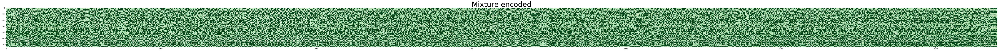

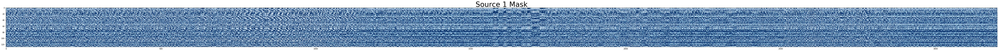

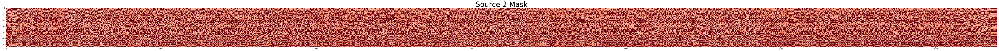

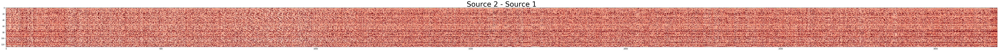

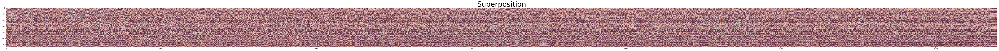

In [28]:
# Tasnet with also some extra reindexing of the basis
simple_tasnet_model_path = '/home/thymios/tn_mask/augmented/WSJMIX_0.5_ESC50_0.5/'
a_tasnet_model = simple_tasnet.GLNFullThymiosCTN.load_best_model(simple_tasnet_model_path, 128, 21)
# mask_enc = a_tasnet_model.fe[0].weight.detach().cpu().squeeze().numpy().T
# mask_dec = a_tasnet_model.be.weight.detach().cpu().squeeze().numpy().T


enc_basis = a_tasnet_model.fe[0].weight.squeeze().detach().cpu().numpy()
enc_bias = a_tasnet_model.fe[0].bias.squeeze().detach().cpu().numpy()

e = enc_basis.T[:, np.argsort(np.sum(np.abs(enc_basis.T), axis=0))]
new_bias = enc_bias[np.argsort(np.sum(np.abs(enc_basis.T), axis=0))]

a_tasnet_model.fe[0].weight = torch.nn.Parameter(torch.tensor(e.T).unsqueeze(1))
a_tasnet_model.fe[0].bias = torch.nn.Parameter(torch.tensor(new_bias).squeeze())


mix_encoded = a_tasnet_model.fe[0](torch.tensor(mix_wav).unsqueeze(0).unsqueeze(0))
s1_encoded = a_tasnet_model.fe[0](torch.tensor(s1_wav).unsqueeze(0).unsqueeze(0))
s2_encoded = a_tasnet_model.fe[0](torch.tensor(s2_wav).unsqueeze(0).unsqueeze(0))

mix_encoded = a_tasnet_model.fe[1](mix_encoded).detach().numpy()
s1_encoded = a_tasnet_model.fe[1](s1_encoded).detach().numpy()
s2_encoded = a_tasnet_model.fe[1](s2_encoded).detach().numpy()

plot_encoded(mix_encoded.squeeze(), s1_encoded.squeeze(), s2_encoded.squeeze(), exponent=0.1)

In [57]:
# Check what happens between datasets
# First load a model trained on WSJ for example
mask_model_path = '/home/thymios/tn_mask/norm_pad/'
a_mask_model = mask_tasnet.CTN.load_best_model(mask_model_path, 'softmax', 32, 21, 2.)

asdfasddfsasfdasfda
/home/thymios/afes/norm_pad/
/home/thymios/afes/norm_pad/reg_softmax_L_32_N_21


In [58]:
a_mask_model

CTN(
  (afe): AdaptiveModulatorConvAE(
    (mix_encoder): AdaptiveEncoder1D(
      (conv): Conv1d(1, 32, kernel_size=(21,), stride=(10,), padding=(10,))
    )
    (decoder): AdaptiveDecoder1D(
      (deconv): ConvTranspose1d(64, 2, kernel_size=(21,), stride=(10,), padding=(10,), output_padding=(9,), groups=2)
    )
  )
  (encoder): AdaptiveEncoder1D(
    (conv): Conv1d(1, 32, kernel_size=(21,), stride=(10,), padding=(10,))
  )
  (decoder): AdaptiveDecoder1D(
    (deconv): ConvTranspose1d(64, 2, kernel_size=(21,), stride=(10,), padding=(10,), output_padding=(9,), groups=2)
  )
  (ln_in): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (l1): Conv1d(32, 256, kernel_size=(1,), stride=(1,))
  (sm): ModuleList(
    (0): TCN(
      (m): ModuleList(
        (0): Conv1d(256, 512, kernel_size=(1,), stride=(1,))
        (1): PReLU(num_parameters=1)
        (2): GlobalLayerNorm()
        (3): Conv1d(512, 512, kernel_size=(3,), stride=(1,), padding=(1,), groups=512

In [59]:
# Try to do inference with different loaders
n_samples = 3000 
batch_size = 2

wsj_normpad_gen = wsjnormpad_loader.get_data_generators(
            [WSJ_MIX_2_8K_PREPROCESSED_TEST_P], bs=batch_size,
            n_jobs=4, get_top=[n_samples],
            return_items=['mixture_wav_norm', 'clean_sources_wavs_norm'])[0]

these_args = argparse.Namespace(
            input_dataset_p=[WSJ_MIX_HIERARCHICAL_P + '/test/', ESC50_HIERARCHICAL_P + '/test/'],
            datasets_priors=[0.5, 0.5],
            batch_size=batch_size,
            n_jobs=4,
            n_samples=n_samples,
            return_items=['wav'],
            fs=8000.,
            selected_timelength=4.,
            n_sources=2,
            max_abs_snr=2.5,
            fixed_seed=8
        )

data_loader = augmented_dataloader.AugmentedOnlineMixingDataset(
    **vars(these_args))
wsj_half_esc50_gen = augmented_dataloader.get_data_gen_from_loader(data_loader)

these_args = argparse.Namespace(
            input_dataset_p=[ESC50_HIERARCHICAL_P + '/test/'],
            datasets_priors=[1.],
            batch_size=batch_size,
            n_jobs=4,
            n_samples=n_samples,
            return_items=['wav'],
            fs=8000.,
            selected_timelength=4.,
            n_sources=2,
            max_abs_snr=2.5,
            fixed_seed=8
        )

data_loader = augmented_dataloader.AugmentedOnlineMixingDataset(
    **vars(these_args))
esc50_gen = augmented_dataloader.get_data_gen_from_loader(data_loader)

these_args = argparse.Namespace(
            input_dataset_p=[WSJ_MIX_HIERARCHICAL_P + '/test/'],
            datasets_priors=[1.],
            batch_size=batch_size,
            n_jobs=4,
            n_samples=n_samples,
            return_items=['wav'],
            fs=8000.,
            selected_timelength=4.,
            n_sources=2,
            max_abs_snr=2.5,
            fixed_seed=8
        )

data_loader = augmented_dataloader.AugmentedOnlineMixingDataset(
    **vars(these_args))
wsj_gen = augmented_dataloader.get_data_gen_from_loader(data_loader)

Dataset is fixed for: 3000 samples
Dataset is fixed for: 3000 samples
Dataset is fixed for: 3000 samples


In [60]:
# define  an si-sdr loss
sisdr_loss = sisdr_lib.PermInvariantSISDR(batch_size=batch_size,
                                            n_sources=2,
                                            zero_mean=True,
                                            backward_loss=False,
                                            improvement=True,
                                            return_individual_results=True)

In [61]:
model = torch.nn.DataParallel(a_mask_model).to(torch.device('cuda:2'))

In [62]:
# Evaluate on WSJnorm pad
def evaluate_on_generator(model, loss_func, generator, generator_name='WSJ'):
    acc = []
    with torch.no_grad():
        for data in tqdm(generator, desc='Validation on {}'.format(generator_name)):
            m1wavs = data[0].unsqueeze(1).to(torch.device('cuda:2'))
            clean_wavs = data[-1].to(torch.device('cuda:2'))

            target_masks = model.module.afe.get_target_masks_tensor(clean_wavs)
            enc_masks = model.module(m1wavs)

            recon_sources = model.module.infer_source_signals(
                            m1wavs, sources_masks=enc_masks)
            l = loss_func(recon_sources, clean_wavs, initial_mixtures=m1wavs)
            acc += l.tolist()
    return acc 

In [63]:
generators_dict = {'WSJNORMPAD': wsj_normpad_gen, 'WSJ.5ESC.5': wsj_half_esc50_gen, 
                   'ESC': esc50_gen, 'WSJ': wsj_gen}
results_dict = {}

for generator_name, generator in generators_dict.items():
    results = evaluate_on_generator(model, sisdr_loss, generator, generator_name=generator_name)
    results = np.array(results)
    results_dict[generator_name] = {}
    results_dict[generator_name]['mean'] = results.mean()
    results_dict[generator_name]['std'] = results.std()


Validation on WSJ: 100%|██████████| 1500/1500 [01:55<00:00, 12.94it/s]


In [64]:
pprint(results_dict)

{'ESC': {'mean': -0.5022110248853763, 'std': 3.067273335329824},
 'WSJ': {'mean': 15.681921811671307, 'std': 5.552794725812937},
 'WSJ.5ESC.5': {'mean': 6.245478659428656, 'std': 7.120881621173776},
 'WSJNORMPAD': {'mean': 16.00918053655191, 'std': 5.386846051668599}}


In [46]:
# Try to load the other autoencoder to see what happens
esc50_afe_path = '/home/thymios/afes/augmented/ESC50_1.0'
esc50_afe = adaptive_fe.AdaptiveModulatorConvAE.load_best_model(esc50_afe_path, 'softmax', 32, 21)

asdfasddfsasfdasfda
/home/thymios/afes/augmented/ESC50_1.0
/home/thymios/afes/augmented/ESC50_1.0/reg_softmax_L_32_N_21


In [47]:
# Load the weights of the esc50 adaptive frontend to the previous mask model
mask_model_path = '/home/thymios/tn_mask/norm_pad/'
a_mask_model = mask_tasnet.CTN.load_best_model(mask_model_path, 'softmax', 32, 21, 2.)
a_mask_model.encoder = esc50_afe.mix_encoder
a_mask_model.decoder = esc50_afe.decoder
model = torch.nn.DataParallel(a_mask_model).to(torch.device('cuda:2')) 

transfer_generators_dict = {'WSJ': wsj_normpad_gen, 'WSJ.5ESC.5': wsj_half_esc50_gen, 'ESC': esc50_gen}
transfer_results_dict = {}

for generator_name, generator in transfer_generators_dict.items():
    results = evaluate_on_generator(model, sisdr_loss, generator, generator_name=generator_name)
    results = np.array(results)
    transfer_results_dict[generator_name] = {}
    transfer_results_dict[generator_name]['mean'] = results.mean()
    transfer_results_dict[generator_name]['std'] = results.std()

asdfasddfsasfdasfda
/home/thymios/afes/norm_pad/
/home/thymios/afes/norm_pad/reg_softmax_L_32_N_21


Validation on ESC: 100%|██████████| 1500/1500 [01:56<00:00, 12.81it/s]


In [48]:
pprint(transfer_results_dict)

{'ESC': {'mean': -1.8115863005841772, 'std': 1.4104247364030793},
 'WSJ': {'mean': -1.5310933453824391, 'std': 0.35873673514567017},
 'WSJ.5ESC.5': {'mean': -1.710626550850769, 'std': 1.0811299594468777}}


In [ ]:
# Try to sort the channels first based on similarity?
# Try 